# Scratch work for Project 2

We evaluate the level of polarization within the Senate of the 113th Congress using a bipartite graph of the Senators and the Senate bills. We find that polarization along party lines does exist in the Senate of this Congress, but that through the application of the island method focused on foreign and defense policy bills, clusters within the parties form along with one Senator appearing to vote more in line with the opposition party. The 113th Congress occurred during the years 2013-2014. From wikipedia (https://en.wikipedia.org/wiki/113th_United_States_Congress), 
Senate Democrats had a 55-45 majority for most of the 113th Congress.

In [997]:
# Import libraries as needed
import warnings
warnings.filterwarnings('ignore')
import pandas as pd
import numpy as np
import networkx as nx
from networkx.algorithms import bipartite
import matplotlib.pyplot as plt

# Data Wrangling
All data is retrieved from the site voteview.com in JSON format.

### Senator Votes
Read in the individual Senator votes by rollnumber.
- congress: 113 confirms the data is correct
- icpsr: unique identifier for each Senator
- cast_code: actual vote cast based on the following codes
  - 1: Yea
  - 6: Nay
  - 7: Present
  - 9: Not Voting (Abstention)
 - rollnumber: vote for the Senate of that Congress. Number increments with each vote.



In [998]:
# https://voteview.com/static/data/out/votes/S113_votes.json
s113_votes_raw_df = pd.read_json('S113_votes.json')

In [999]:
s113_votes_raw_df.head()

,congress,icpsr,cast_code,chamber,rollnumber,prob
0,113,14009,1,Senate,1,91.1
1,113,14203,1,Senate,1,99.4
2,113,14226,1,Senate,1,85.4
3,113,14230,1,Senate,1,99.6
4,113,14307,1,Senate,1,99.3


Next, we trim the dataframe to only contain $icpsr$, $cast\_code$, and $rollnumber$. The JSON from voteview.com contains Barack Obama votes on the Senate rollnumbers. We have removed his votes by $icpsr$ "99911" as he was President and not a Senator at the time.

In [1000]:
# Select only the columns I want to use later
s113_votes_sel_df = s113_votes_raw_df[['icpsr', 'cast_code', 'rollnumber']]
# Convert all to string
s113_votes_sel_df = s113_votes_sel_df.astype(str)
# Remove Barack Obama from the list (icpsr==99911)
s113_votes_sel_df = s113_votes_sel_df.drop(s113_votes_sel_df[s113_votes_sel_df.icpsr == '99911'].index)
s113_votes_sel_df = s113_votes_sel_df.reset_index(drop=True)
s113_votes_sel_df.head()

,icpsr,cast_code,rollnumber
0,14009,1,1
1,14203,1,1
2,14226,1,1
3,14230,1,1
4,14307,1,1


We retrieve all the unique IDs from the $icpsr$ column, which is the unique identifier of each Senator. We confirm the overall Senator count is 105. The list of Senator IDs will be needed later to define the Senator graph nodes.

In [1001]:
senator_ids = s113_votes_sel_df['icpsr'].unique()

In [1002]:
senator_ids

array(['14009', '14203', '14226', '14230', '14307', '14440', '14503',
       '14651', '14709', '14806', '14852', '14858', '14871', '14914',
       '14920', '14921', '14922', '15011', '15015', '15021', '15039',
       '15054', '15408', '15424', '15425', '20100', '20101', '20115',
       '20707', '20713', '20717', '20730', '20735', '20930', '21173',
       '29142', '29147', '29345', '29373', '29386', '29389', '29512',
       '29534', '29548', '29555', '29566', '29722', '29732', '29735',
       '29754', '29906', '29909', '29918', '29924', '29935', '29940',
       '39310', '40300', '40301', '40304', '40305', '40700', '40701',
       '40702', '40703', '40704', '40705', '40707', '40900', '40902',
       '40904', '40905', '40906', '40907', '40908', '40909', '40910',
       '40915', '40916', '41101', '41102', '41104', '41106', '41107',
       '41110', '41111', '41112', '41300', '41301', '41302', '41303',
       '41304', '41305', '49300', '49308', '49700', '49702', '49703',
       '49706', '946

In [1003]:
len(senator_ids) # 105

105

### Senator Metadata

Read in the Senate members JSON object which contains the metadata for each Senator including $bioname$ and $party\_code$.

In [1004]:
# https://voteview.com/static/data/out/members/S113_members.json
s113_members_raw_df = pd.read_json('S113_members.json')

In [1005]:
s113_members_raw_df.head()

,congress,chamber,icpsr,state_icpsr,district_code,state_abbrev,party_code,occupancy,last_means,bioname,...,died,nominate_dim1,nominate_dim2,nominate_log_likelihood,nominate_geo_mean_probability,nominate_number_of_votes,nominate_number_of_errors,conditional,nokken_poole_dim1,nokken_poole_dim2
0,113,President,99911,99,0,USA,100,0,0,"OBAMA, Barack",...,NaN,-0.358,-0.197,-41.04464,0.88200,327,11,NaN,NaN,NaN
1,113,Senate,49700,41,0,AL,200,0,1,"SESSIONS, Jefferson Beauregard III (Jeff)",...,NaN,0.549,0.130,-101.80298,0.82789,539,45,NaN,0.619,0.082
2,113,Senate,94659,41,0,AL,200,0,1,"SHELBY, Richard C.",...,NaN,0.446,0.575,-107.47205,0.82103,545,52,NaN,0.515,0.602
3,113,Senate,40300,81,0,AK,200,0,1,"MURKOWSKI, Lisa",...,NaN,0.211,-0.304,-157.48950,0.73697,516,82,NaN,0.124,-0.411
4,113,Senate,40900,81,0,AK,100,0,1,"BEGICH, Mark",...,NaN,-0.235,0.150,-48.13809,0.91000,512,21,NaN,-0.241,0.348


We trim the dataframe to contain only the necessary data.

- icpsr: Unique identifier
- state_abbrev: State for which the Senator represents
- party_code: Political party of Senator
- bioname: Full name of Senator
- nominate_dim1: NOMINATE statistic defining the Senator idealogy on a scale of -1 to 1 with -1 being far liberal and 1 being far conservative.

Again, we remove Barack Obama ("99911").

In [1006]:
# icpsr, state_abbrev, party_code, bioname
s113_members_sel_df = s113_members_raw_df[['icpsr','state_abbrev','party_code','bioname','nominate_dim1']]
s113_members_sel_df = s113_members_sel_df.astype(str)
s113_members_sel_df[['nominate_dim1']] = s113_members_sel_df[['nominate_dim1']].astype(float) 
# Remove Barack Obama
s113_members_sel_df = s113_members_sel_df.drop(s113_members_sel_df[s113_members_sel_df.icpsr == '99911'].index)
s113_members_sel_df = s113_members_sel_df.reset_index(drop=True)
s113_members_sel_df.head()

,icpsr,state_abbrev,party_code,bioname,nominate_dim1
0,49700,AL,200,"SESSIONS, Jefferson Beauregard III (Jeff)",0.549
1,94659,AL,200,"SHELBY, Richard C.",0.446
2,40300,AK,200,"MURKOWSKI, Lisa",0.211
3,40900,AK,100,"BEGICH, Mark",-0.235
4,15039,AZ,200,"McCAIN, John Sidney, III",0.381


Confirm Senator count is 105 to match previous input file.

In [1007]:
len(s113_members_sel_df) # 105

105

In [1008]:
s113_members_sel_df.head()
# icpsr, state_abbrev, party_code, bioname

,icpsr,state_abbrev,party_code,bioname,nominate_dim1
0,49700,AL,200,"SESSIONS, Jefferson Beauregard III (Jeff)",0.549
1,94659,AL,200,"SHELBY, Richard C.",0.446
2,40300,AK,200,"MURKOWSKI, Lisa",0.211
3,40900,AK,100,"BEGICH, Mark",-0.235
4,15039,AZ,200,"McCAIN, John Sidney, III",0.381


In [1009]:
# Get unique party codes
party_codes = s113_members_sel_df['party_code'].unique()
party_codes

array(['200', '100', '328'], dtype=object)

Check $party\_code$ values.

- 100: Democrat
- 200: Republican
- 328: Independent (for 113 Congress, both independents align idealogically with Democrats)

### Rollcall Metadata
Read in rollcall votes JSON which contains the metadata for each rollnumber vote. Trim dataframe to columns:
- date: Date of vote
- rollnumber: Numerical identifier of vote for the Senate chamber of the 113th Congress
- bill_number: Formal bill identifier
- vote_result: Vote outcome
- vote_desc: Vote description
- clause_codes: Code to categorize content of vote

In [1010]:
# https://voteview.com/static/data/out/rollcalls/S113_rollcalls.json
s113_rollcalls_raw_df = pd.read_json('S113_rollcalls.json')

In [1011]:
# len is 657, is 657 votes
len(s113_rollcalls_raw_df[[]])
s113_rollcalls_sel_df = s113_rollcalls_raw_df[['date', 'rollnumber', 'bill_number', 'vote_result', 'vote_desc', 'clausen_codes']]
s113_rollcalls_sel_df['rollnumber'] = s113_rollcalls_sel_df['rollnumber'].astype(str)
s113_rollcalls_sel_df['date'] = s113_rollcalls_sel_df['date'].astype(str)
s113_rollcalls_sel_df.head()
# date, rollnumber, bill_number, vote_result, vote_desc, clausen_codes

,date,rollnumber,bill_number,vote_result,vote_desc,clausen_codes
0,2013-01-24,1,SRES15,Resolution Agreed to,A resolution to improve procedures for the con...,[Miscellaneous Policy]
1,2013-01-24,2,SRES16,Resolution Agreed to,A resolution amending the Standing Rules of th...,[Miscellaneous Policy]
2,2013-01-28,3,HR152,Amendment Rejected,To offset the cost of the bill with rescission...,[Government Management]
3,2013-01-28,4,HR152,Bill Passed,A bill making supplemental appropriations for ...,[Government Management]
4,2013-01-29,5,PN42,Nomination Confirmed,"John Forbes Kerry, of Massachusetts, to be Sec...",[Foreign and Defense Policy]


Convert Clausen codes list to dummy variables and append to dataframe

In [1012]:
claus_codes = pd.get_dummies(s113_rollcalls_sel_df['clausen_codes'].explode()).sum(level=0)
claus_codes.columns = ['cc_agr','cc_civ_lib','cc_for_def','cc_gov_mgmt','cc_misc','cc_soc_wel']
claus_codes

,cc_agr,cc_civ_lib,cc_for_def,cc_gov_mgmt,cc_misc,cc_soc_wel
0,0,0,0,0,1,0
1,0,0,0,0,1,0
2,0,0,0,1,0,0
3,0,0,0,1,0,0
4,0,0,1,0,0,0
...,...,...,...,...,...,...
652,0,0,1,0,0,0
653,0,0,0,1,0,0
654,0,0,0,1,0,0
655,0,0,0,1,0,0


In [1013]:
s113_rollcalls_sel_df = s113_rollcalls_sel_df.reset_index(drop=True).join(claus_codes)
s113_rollcalls_sel_df = s113_rollcalls_sel_df.drop(columns=['clausen_codes'])
s113_rollcalls_sel_df.head()

,date,rollnumber,bill_number,vote_result,vote_desc,cc_agr,cc_civ_lib,cc_for_def,cc_gov_mgmt,cc_misc,cc_soc_wel
0,2013-01-24,1,SRES15,Resolution Agreed to,A resolution to improve procedures for the con...,0,0,0,0,1,0
1,2013-01-24,2,SRES16,Resolution Agreed to,A resolution amending the Standing Rules of th...,0,0,0,0,1,0
2,2013-01-28,3,HR152,Amendment Rejected,To offset the cost of the bill with rescission...,0,0,0,1,0,0
3,2013-01-28,4,HR152,Bill Passed,A bill making supplemental appropriations for ...,0,0,0,1,0,0
4,2013-01-29,5,PN42,Nomination Confirmed,"John Forbes Kerry, of Massachusetts, to be Sec...",0,0,1,0,0,0


### Clausen Categories

The Clausen codes broadly define each bill according to the categories defined below.

- Government Management: Environmental control; government regulation of business; natural resource management; government ownership of business; government control of the economy; budget balancing; tax policy; interest rates; management of the bureaucracy; etc.
- Social Welfare: Social security; public housing; urban renewal; labor regulation; education; urban affairs; employment opportunities and rewards; welfare; medicare; unemployment; minimum wage; legal services; immigration, etc.
- Agriculture: Price supports and subsidies; commodity control; acreage limitations; etc.
- Civil Liberties: Civil rights; equality; criminal procedure; privacy; guarantees of the Bill of Rights; slavery; Hatch Act; etc.
- Foreign and Defense Policy: International policy; foreign aid; aid to international organizations; armament policy; defense procurement; international trade; military pensions; etc.
- Miscellaneous Policy: Unclassifiable or unidentifiable votes; all votes concerned with internal organization of Congress; procedural motions.

From: https://voteview.com/articles/issue_codes

### Senate Bills
Focus on only the Senate bills, thus filter votes that match the pattern of $bill\_number$ with 'S' followed by a number.

In [1014]:
bill_numbers = s113_rollcalls_sel_df['bill_number']
bill_numbers = list(bill_numbers)
bill_numbers = [str(x) for x in bill_numbers]
#bill_numbers

In [1015]:
# Regex to get those starting with S and a Number
import re
regex_sen_bill = re.compile(r'^S\d')
senate_bills = list(filter(regex_sen_bill.match, bill_numbers)) # Read Note below
#(senate_bills)

Create dictionary of key $bill\_number$ and value $rollnumber$.

In [1016]:
senate_rollcall_dict = dict(zip(s113_rollcalls_sel_df.bill_number, s113_rollcalls_sel_df.rollnumber))
#senate_rollcall_dict

Create dictionary of $bill\_number$ and $vote\_result$.

In [1017]:
senate_vote_result_dict = dict(zip(s113_rollcalls_raw_df.bill_number, s113_rollcalls_raw_df.vote_result))

Create dictionary of key $bill\_number$ and $vote\_result$ for just the Senate bills.

In [1018]:
senate_bills_result_dict = dict((k, senate_vote_result_dict[k]) for k in senate_bills if k in senate_vote_result_dict)
#senate_bills_result_dict
# Luckily this creation of a dictionary does seem to be using the last entry and thus the final vote

Create a dictionary of key $bill\_number$ and $rollnumber$ for just the Senate bills.

In [1019]:
senate_bills_dict = dict((k, senate_rollcall_dict[k]) for k in senate_bills if k in senate_rollcall_dict)
#senate_bills_dict

Convert dictionary into array of $rollnumber$ for Senate Bills

In [1020]:
rollnumber_list = senate_bills_dict.values()
rollnumber_list = list(rollnumber_list)
#rollnumber_list

Trim dataframe to just Senate bills with metadata based on list of $rollnumber$ for Senate bills

In [1021]:
senate_bills_df = s113_rollcalls_sel_df[s113_rollcalls_sel_df['rollnumber'].isin(rollnumber_list)]
senate_bills_df.head()

,date,rollnumber,bill_number,vote_result,vote_desc,cc_agr,cc_civ_lib,cc_for_def,cc_gov_mgmt,cc_misc,cc_soc_wel
18,2013-02-12,19,S47,Bill Passed,A bill to reauthorize the Violence Against Wom...,0,1,0,0,0,0
25,2013-02-28,26,S16,Cloture on the Motion to Proceed Rejected,A bill to provide for a sequester replacement.,0,0,0,1,0,0
26,2013-02-28,27,S388,Cloture on the Motion to Proceed Rejected,"A bill to appropriately limit sequestration, t...",0,0,0,1,0,0
104,2013-04-18,105,S649,Amendment Agreed to,To reauthorize and improve programs related to...,0,0,0,1,0,0
112,2013-05-06,113,S743,Bill Passed,A bill to restore States' sovereign rights to ...,0,0,0,1,0,0


Check language of all possible $vote\_result$ values to be able to identify affirmation or rejection.

In [1022]:
s113_rollcalls_sel_df['vote_result'].unique()

array(['Resolution Agreed to', 'Amendment Rejected', 'Bill Passed',
       'Nomination Confirmed', 'Motion to Table Agreed to',
       'Motion to Proceed Agreed to', 'Amendment Agreed to',
       'Cloture Motion Rejected', 'Cloture Motion Agreed to',
       'Cloture on the Motion to Proceed Rejected',
       'Motion to Table Failed', 'Motion to Recommit Rejected',
       'Motion Rejected', 'Cloture on the Motion to Proceed Agreed to',
       'Motion Agreed to', 'Motion for Attendance Agreed to',
       'Motion to Table Motion to Recommit Agreed to',
       'Joint Resolution Passed', 'Motion to Proceed Rejected',
       'Motion to Adjourn Rejected', 'Motion to Reconsider Agreed to',
       'Decision of Chair Not Sustained', 'Decision of Chair Sustained',
       'Concurrent Resolution Agreed to', 'Conference Report Agreed to',
       'Bill Defeated', 'Motion to Refer Rejected',
       'Point of Order Not Well Taken'], dtype=object)

Votes resulting in affirmation will contain one of the following:
- 'Agreed'
- 'Passed'
- 'Confirmed'
- 'Decision of Chair Sustained'

Votes resulting in rejection will contain one of the following:
- 'Rejected'
- 'Failed'
- 'Defeated'
- 'Not Well Taken'
- 'Decision of Chair Not Sustained'

Create Boolean column $passed$ based on the $vote\_result$ column values.

In [1023]:
passed_list = ['Agreed','Passed','Confirmed', 'Decision of Chair Sustained']
def bill_passed(row):
    result = 0
    if any(word in row['vote_result'] for word in passed_list):
        result=1
    return result
senate_bills_df['passed'] = senate_bills_df.apply(bill_passed, axis=1)
senate_bills_df.head()

,date,rollnumber,bill_number,vote_result,vote_desc,cc_agr,cc_civ_lib,cc_for_def,cc_gov_mgmt,cc_misc,cc_soc_wel,passed
18,2013-02-12,19,S47,Bill Passed,A bill to reauthorize the Violence Against Wom...,0,1,0,0,0,0,1
25,2013-02-28,26,S16,Cloture on the Motion to Proceed Rejected,A bill to provide for a sequester replacement.,0,0,0,1,0,0,0
26,2013-02-28,27,S388,Cloture on the Motion to Proceed Rejected,"A bill to appropriately limit sequestration, t...",0,0,0,1,0,0,0
104,2013-04-18,105,S649,Amendment Agreed to,To reauthorize and improve programs related to...,0,0,0,1,0,0,1
112,2013-05-06,113,S743,Bill Passed,A bill to restore States' sovereign rights to ...,0,0,0,1,0,0,1


Trim the dataframe of individual votes cast to just the Senate bills by $rollnumber$.

In [1024]:
senate_bill_votes_df = s113_votes_sel_df[s113_votes_sel_df['rollnumber'].isin(rollnumber_list)]
senate_bill_votes_df

,icpsr,cast_code,rollnumber
1799,14009,1,19
1800,14203,1,19
1801,14226,6,19
1802,14230,1,19
1803,14307,1,19
...,...,...,...
57289,49700,6,573
57290,49702,1,573
57291,49703,6,573
57292,49706,6,573


Senator 14920 is not contained the above dataframe. This absence is due to the fact that this Senator never voted on a Senate bill of the 113th Congress. Senator 14920 is John Kerry, who became Secretary of State early in 2013 at the start of Obama's second Presidential term.

## Bipartite Graph Construction

Create a bipartite graph of Senator nodes and Senate bill nodes.

First, create Senator nodes with $icpsr$ as the key value, bipartite value as '0' along with name, party, state, and NOMINATE dimension.

In [1025]:
G = nx.Graph()

for index, sen in s113_members_sel_df.iterrows():
    G.add_node(sen.icpsr, bipartite=0, 
               name=sen.bioname,
               party=sen.party_code,
               state=sen.state_abbrev,
               nom_dim=sen.nominate_dim1)
    
len(G.nodes())

105

Create the Senate bill nodes with rollnumber as the key value, bipartite value as '1' along with bill date, formal bill number, passed result, description, and dummy variables for the Clausen codes.

In [1026]:
for index, bill in senate_bills_df.iterrows():
    G.add_node(bill.rollnumber, bipartite=1,
               date=bill.date,
               bill_number=bill.bill_number,
               passed=bill.passed,
               desc=bill.vote_desc,
               cc_agr=bill.cc_agr,
               cc_civ_lib=bill.cc_civ_lib, 
               cc_for_def=bill.cc_for_def,
               cc_gov_mgmt=bill.cc_gov_mgmt,
               cc_misc=bill.cc_misc,
               cc_soc_wel=bill.cc_soc_wel)
len(G.nodes())

141

Separate the nodes into two unique sets: Senators and Senate bill votes.

In [1027]:
senator_nodes = {n for n, d in G.nodes(data=True) if d["bipartite"] == 0}
vote_nodes = set(G) - senator_nodes

In [1028]:
len(senator_nodes)

105

In [1029]:
len(vote_nodes)

36

Create the edges for each $cast\_code$ between a Senator and a bill.

In [1030]:
for index, row in senate_bill_votes_df.iterrows():
    G.add_edge(row.icpsr, row.rollnumber, vote=row.cast_code)

In [1031]:
(len(G.nodes()), len(G.edges()))

(141, 3597)

Check if the graph is connected.

In [1032]:
nx.is_connected(G)

False

The graph is not connected because $icpsr$ of 14920 (John Kerry) did not vote on any Senate bills as noted above.

Retrieve the largest connected component subgraph, which contains the other 104 senators and the 36 Senate bills.

In [1033]:
graphs = list(nx.connected_component_subgraphs(G))
g_s113 = graphs[0]
len(g_s113.nodes())

140

Define a function to create a label map for the Networkx graph object. The name is used to label the Senator nodes, and the bill number is used to label the bill nodes.

In [1034]:
my_labels = [ v[1]['name'] if v[1]['bipartite']==0 else v[1]['bill_number'] for v in g_s113.nodes(data=True)]
len(my_labels)
label_map = { g_s113.nodes()[i] : my_labels[i] for i in range(len(g_s113.nodes())) }

def generateLabelMapForNodes(graph):
    my_labels = [ v[1]['name'] if v[1]['bipartite']==0 else v[1]['bill_number'] for v in graph.nodes(data=True)]
    len(my_labels)
    label_map = { graph.nodes()[i] : my_labels[i] for i in range(len(graph.nodes())) }
    return label_map

Define a function to create a color map for the nodes of the Networkx graph object. Nodes are colored according to the following rules.

- Democrats and Independents: Blue
- Republicans: Red
- Bills with final vote in the affirmative: Green
- Bills with final vote in rejection: Orange

In [1035]:
# Assign node colors

my_node_color = [ ]

for node in g_s113.nodes(data=True):
    if node[1]['bipartite'] == 0: # Senator
        if node[1]['party'] == '100' or node[1]['party'] == '328': # Democrat
            my_node_color.append('blue')
        else: # Republican
            my_node_color.append('red')
    else: # Bill
        if node[1]['passed'] == 1: # Passed
            my_node_color.append('green')
        else: # Not Passed
            my_node_color.append('orange')
            
def generateColorMapForNodes(graph):
    my_node_color = [ ]

    for node in graph.nodes(data=True):
        if node[1]['bipartite'] == 0: # Senator
            if node[1]['party'] == '100' or node[1]['party'] == '328': # Democrate
                my_node_color.append('blue')
            else: # Republican
                my_node_color.append('red')
        else: # Bill
            if node[1]['passed'] == 1: # Passed
                my_node_color.append('green')
            else: # Not Passed
                my_node_color.append('orange')
    return my_node_color

Define function to create a color map for the edges of the Networkx graph object. Vote edges are colored according to the following rules.

- 'Yea': Green
- 'Nay': Orange
- Other vote: Gray

In [1036]:
# Assign edge colors based on vote attribute.

my_edge_color = [ ]

for ed in g_s113.edges(data=True):
    if ed[2]['vote'] == '1':
        my_edge_color.append('green')
    elif ed[2]['vote'] == '6':
        my_edge_color.append('orange')
    else:
        my_edge_color.append('gray')

def generateColorMapForEdges(graph):
    my_edge_color = [ ]

    for ed in graph.edges(data=True):
        if ed[2]['vote'] == '1':
            my_edge_color.append('green')
        elif ed[2]['vote'] == '6':
            my_edge_color.append('orange')
        else:
            my_edge_color.append('gray')
    return my_edge_color

Separate the nodes into three sets: Republican nodes, Democrat nodes, and Senate bill nodes in order to properly position the nodes for display of the bipartite graph in three columns.

In [1037]:
# Assign the position

# Separate into 3 sets
senator_nodes = {n for n, d in g_s113.nodes(data=True) if d["bipartite"] == 0}
vote_nodes = set(g_s113) - senator_nodes
rep_nodes = {n for n, d in g_s113.nodes(data=True) if d["bipartite"] == 0 and d["party"] == '200'}
dem_nodes = {n for n, d in g_s113.nodes(data=True) if d["bipartite"] == 0 and (d["party"] == '100' or d["party"] == '328')}

Assign the x-axis of the position based on the set of the node.

In [1038]:
# Separate by group
pos = {}

# Update position for node from each group
pos.update((node, (1, index)) for index, node in enumerate(dem_nodes))
pos.update((node, (2, index)) for index, node in enumerate(vote_nodes))
pos.update((node, (3, index)) for index, node in enumerate(rep_nodes))

Assign the x-axis of the position based on the NOMINATE dimension of each node.

In [1039]:
# Separate by group
pos_nom_dim = {}

# Update position for node from each group
pos_nom_dim.update((node, (s113_members_sel_df.loc[s113_members_sel_df['icpsr'] == node, 'nominate_dim1'].item(), index)) for index, node in enumerate(dem_nodes))
pos_nom_dim.update((node, (0, index+11)) for index, node in enumerate(vote_nodes))
pos_nom_dim.update((node, (s113_members_sel_df.loc[s113_members_sel_df['icpsr'] == node, 'nominate_dim1'].item(), index+6)) for index, node in enumerate(rep_nodes))

Confirm the graph is connected.

In [1040]:
# graph[0] has all the nodes and edges
nx.is_connected(g_s113)

True

### Bipartite Graph: All Senators and Bills
Plot the graph of all the nodes, all the edges and x-axis value based on the NOMINATE dimension.

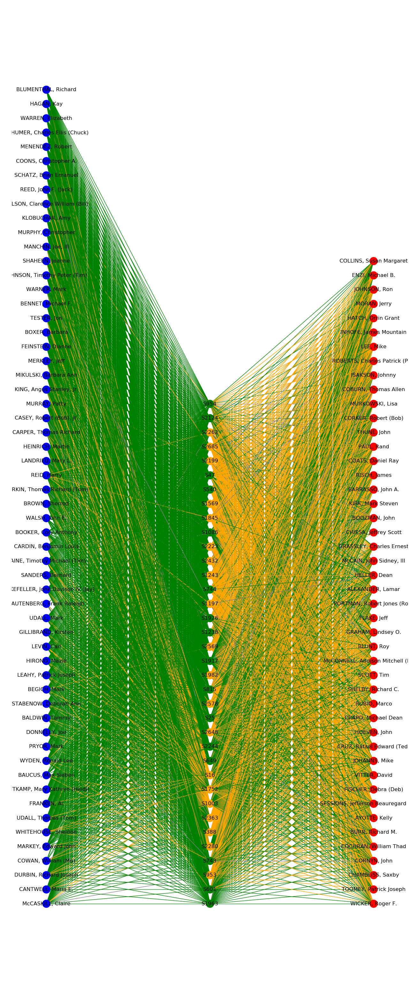

In [1041]:
plt.figure(figsize = (16, 40))
plt.tight_layout()
plt.axis("off")
nx.draw_networkx(g_s113, 
                 node_color = my_node_color,
                 edge_color = my_edge_color,
                 labels = label_map,
                 pos = pos)

The above plot shows the Democrats on the left, Republicans on the right, Senate bills in the middle
- Final bill votes in the affirmative are colored green
- Final bill votes in rejection are colored orange
- Edges represent the votes by the Senators

As expected for a Congress with a majority of Democrats, the bills that come to a vote (out of commiittee) are likely to be Democrat-friendly and thus a majority of the voting reflects the partisan divide with green 'Yea' votes by Democrats and orange 'Nay' votes by Republicans.

Write graph object to .graphml for inspection with Gephi.

In [1042]:
graphml_file = "S113_voting.graphml"
nx.write_graphml( g_s113, graphml_file )

Next, we remove all 'Nay' votes to see if a clearer pattern emerges with just the 'Yea' votes.

In [1043]:
dict_edge = nx.get_edge_attributes(g_s113, "vote")
dict_edge_remove = {key:val for key, val in dict_edge.items() if val == '6'}

In [1044]:
g_s113_yes_edges = g_s113
g_s113_yes_edges.remove_edges_from(list(dict_edge_remove))

In [1045]:
# Update map of edges
edge_map = generateColorMapForEdges(g_s113_yes_edges)

### Bipartite Graph: Only Yea Votes

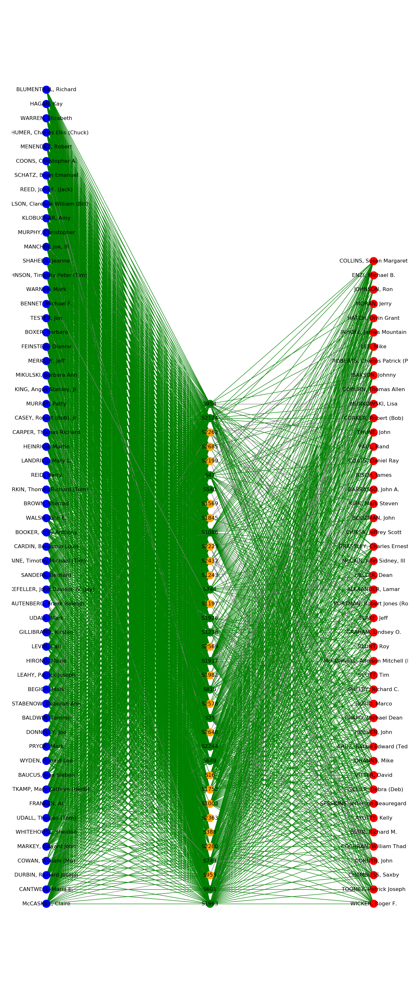

In [1046]:
plt.figure(figsize = (16, 40))
plt.tight_layout()
plt.axis("off")
nx.draw_networkx(g_s113_yes_edges, 
                 node_color = my_node_color,
                 edge_color = edge_map,
                 labels = label_map,
                 pos = pos)

By removing the 'Nay' votes, we do see some bills with predominantly 'Yea' votes by Republicans. The left side of the plot does indicate a much higher volume of 'Yea' votes by Democrats.

### Bipartite Graph: Only Nay Votes
Now, let's inverse the above and only display 'Nay' votes.

In [1047]:
dict_edge = nx.get_edge_attributes(g_s113, "vote")
dict_edge_remove = {key:val for key, val in dict_edge.items() if val == '1'}

In [1048]:
# Reset g_s113 graph
graphs = list(nx.connected_component_subgraphs(G))
g_s113 = graphs[0]
g_s113_no_edges = g_s113
g_s113_no_edges.remove_edges_from(list(dict_edge_remove))

In [1049]:
# Update map of edges
edge_map = generateColorMapForEdges(g_s113_no_edges)

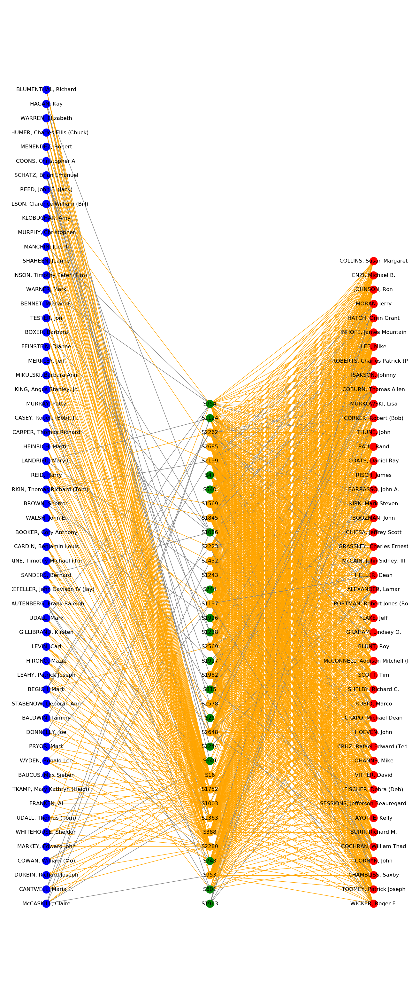

In [1050]:
plt.figure(figsize = (16, 40))
plt.tight_layout()
plt.axis("off")
nx.draw_networkx(g_s113_no_edges, 
                 node_color = my_node_color,
                 edge_color = edge_map,
                 labels = label_map,
                 pos = pos)

We do see the majority of 'Nay' votes are cast by Republicans and three final bill votes receive a high number of 'Nay' votes by Democreats. (S16, S2280, S1003). The voting does fall predominantly along party lines and consistent with a Democratic majority but some bill votes indicate exceptions to that assumption.

### Bipartite Graph: Bills with Affirmative Final Vote

For the 113th Congress, only 10 Senate bills were passed by the Senate. A final affirmative vote does not indicate the bill was passed and signed into law.

Now, let's show just the bills with final votes in the affirmative.

In [1051]:
# Reset g_s113 graph
graphs = list(nx.connected_component_subgraphs(G))
g_s113 = graphs[0]
# Get all the nodes with Passed = 0
bills_not_passed_nodes = {n for n, d in g_s113.nodes(data=True) if d["bipartite"] == 1 and d['passed'] == 0}
# Get all the edges connected to Removed Nodes
edges_to_remove = nx.edges(g_s113, bills_not_passed_nodes)
# Remove those nodes from the Graph
g_s113_passed_bills = g_s113
g_s113_passed_bills.remove_nodes_from(bills_not_passed_nodes)
# Remove those edges
g_s113_passed_bills.remove_edges_from(edges_to_remove)
# EdgeColorMap
node_map = generateColorMapForNodes(g_s113_passed_bills)
edge_map = generateColorMapForEdges(g_s113_passed_bills)
label_map = generateLabelMapForNodes(g_s113_passed_bills)

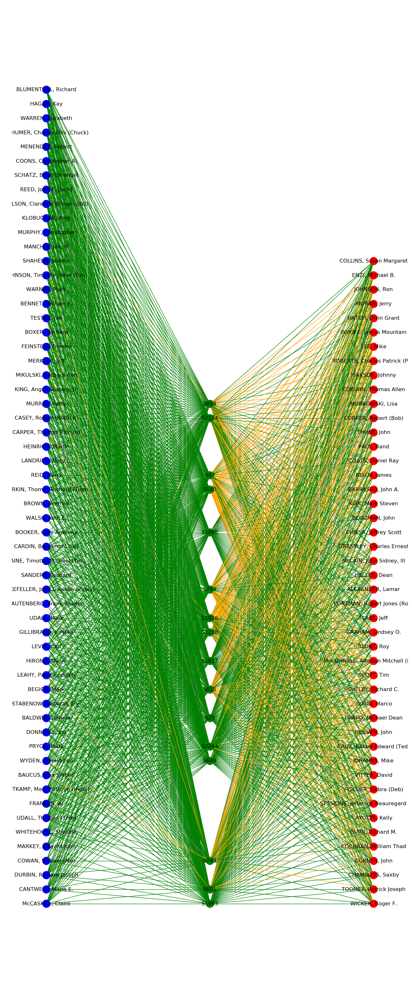

In [1052]:
# Plot
plt.figure(figsize = (16, 40))
plt.tight_layout()
plt.axis("off")
nx.draw_networkx(g_s113_passed_bills, 
                 node_color = node_map,
                 edge_color = edge_map,
                 labels = label_map,
                 pos = pos)

Of the 36 Senate bills in the 113th Congress, only 16 bills received an affirmative final vote. For those with a final affirmative vote, each one garnered high Democratic support.

### Bipartite Graph: Bills with Negative Final Vote

Now, only bills that received a negative final vote.

In [1053]:
# Reset g_s113 graph
graphs = list(nx.connected_component_subgraphs(G))
g_s113 = graphs[0]
# Get all the nodes with Passed = 0
bills_passed_nodes = {n for n, d in g_s113.nodes(data=True) if d["bipartite"] == 1 and d['passed'] == 1}
# Get all the edges connected to Removed Nodes
edges_to_remove = nx.edges(g_s113, bills_passed_nodes)
# Remove those nodes from the Graph
g_s113_not_passed_bills = g_s113
g_s113_not_passed_bills.remove_nodes_from(bills_passed_nodes)
# Remove those edges
g_s113_not_passed_bills.remove_edges_from(edges_to_remove)
# EdgeColorMap
node_map = generateColorMapForNodes(g_s113_not_passed_bills)
edge_map = generateColorMapForEdges(g_s113_not_passed_bills)
label_map = generateLabelMapForNodes(g_s113_not_passed_bills)

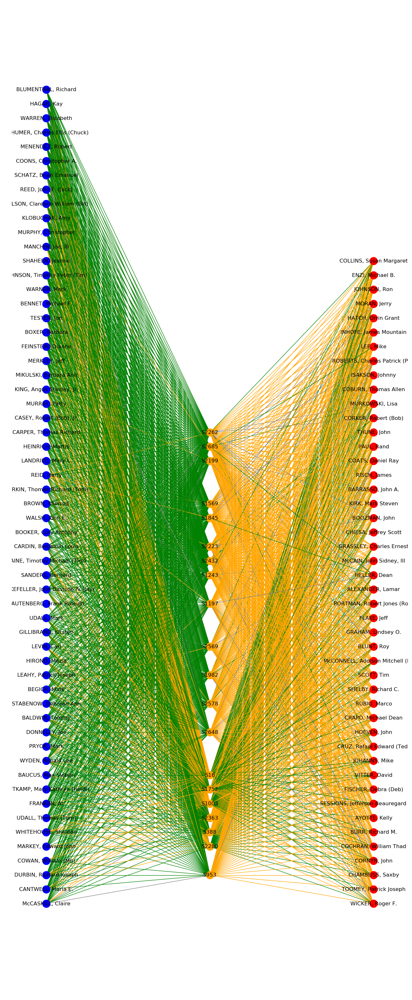

In [1054]:
# Plot
plt.figure(figsize = (16, 40))
plt.tight_layout()
plt.axis("off")
nx.draw_networkx(g_s113_not_passed_bills, 
                 node_color = node_map,
                 edge_color = edge_map,
                 labels = label_map,
                 pos = pos)

Of the 36 Senate bills, 20 bills received a negative final bill vote. Again, we note that three bills indicate an inverse of expectations: high Republican support and low Democratic support (S16, S1003, S2280).

# Island Method on Foreign and Defense Policy Bills

To focus the voting analysis even further, we've chosen to separate the Senate bills by Clausen category and then apply the island method on the bills categorized as foreign and defense policy. We wanted to assess the level of polarization on bills often receiving a high level of bipartisan support.

The plot below shows all the votes for just the bills categorized as foreign and defense policy. Of the eight bills, only half receive a final affirmative vote. Of the 10 Senate bills passed during the 113th Congress, only one is categorized as foreign and defense policy (S1917). Three bills (S1917, S25, S1963) appear to receive near unanimous approval.

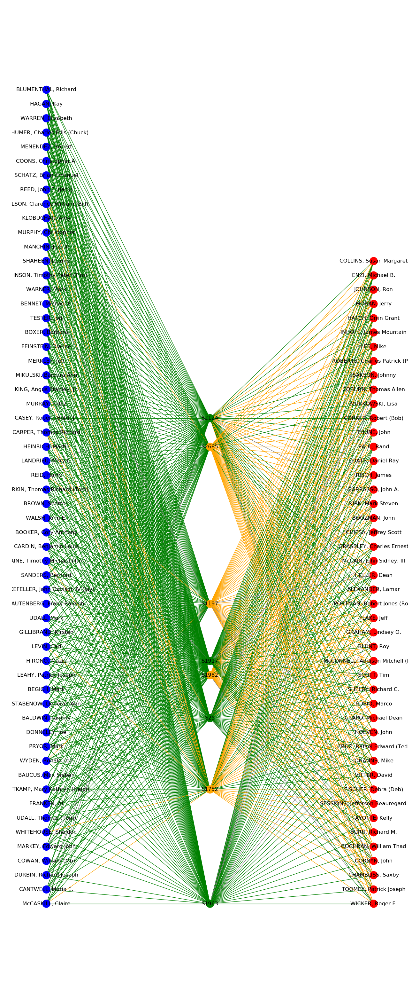

In [1055]:
# Reset g_s113 graph
graphs = list(nx.connected_component_subgraphs(G))
g_s113 = graphs[0]
# Get all the nodes with cc_agr = 0, these will be nodes to remove in order to focus on Foreign and Defense Policy
nodes_to_remove = {n for n, d in g_s113.nodes(data=True) if d["bipartite"] == 1 and d['cc_for_def'] == 0}
# Get all the edges connected to Removed Nodes
edges_to_remove = nx.edges(g_s113, nodes_to_remove)
# Remove those nodes from the Graph
g_s113_bills_cc_agr = g_s113
g_s113_bills_cc_agr.remove_nodes_from(nodes_to_remove)
# Remove those edges
g_s113_bills_cc_agr.remove_edges_from(edges_to_remove)
# EdgeColorMap
node_map = generateColorMapForNodes(g_s113_bills_cc_agr)
edge_map = generateColorMapForEdges(g_s113_bills_cc_agr)
label_map = generateLabelMapForNodes(g_s113_bills_cc_agr)

# Plot
plt.figure(figsize = (16, 40))
plt.tight_layout()
plt.axis("off")
nx.draw_networkx(g_s113_bills_cc_agr, 
                 node_color = node_map,
                 edge_color = edge_map,
                 labels = label_map,
                 pos = pos)

### Graph Construction

In order to evaluate the Senator voting patterns and level of polarization based on the foreign and defense policy Senate bills, we separate each bill vote node into two nodes, one node for 'Yea' votes and another for 'Nay' votes. By separating the positive and negative votes, we can assess which Senators share a higher number of common neighbors, otherwise all Senators would share the same common neighbors because every Senators votes on almost every Senate bill as that is their job.

First, add the nodes for each Senator to the graph object. As expected, the result is 105 nodes, one for each Senator.

In [1056]:
G_bills_split = nx.Graph()

for index, sen in s113_members_sel_df.iterrows():
    G_bills_split.add_node(sen.icpsr, bipartite=0, 
                           name=sen.bioname,
                           party=sen.party_code,
                           state=sen.state_abbrev,
                           nom_dim=sen.nominate_dim1)
    
len(G_bills_split.nodes())

105

Next, we add a node for each foreign and defense policy related bill and postfix '-P' or '-NP' to the $rollnumber$ value to indicate a positive or not positive vote. This approach results in the addition of 16 nodes, two each for the 8 bills.

In [1057]:
# Loop through the bills and only add defense bills twice
for index, bill in senate_bills_df.iterrows():
    if bill.cc_for_def == 1:
        node_id = bill.rollnumber + '-P'
        G_bills_split.add_node(node_id, bipartite=1,
                   date=bill.date,
                   bill_number=bill.bill_number,
                   #passed=bill.passed,
                   desc=bill.vote_desc,
                   passed=1)
        node_id = bill.rollnumber + '-NP'
        G_bills_split.add_node(node_id, bipartite=1,
                   date=bill.date,
                   bill_number=bill.bill_number,
                   #passed=bill.passed,
                   desc=bill.vote_desc,
                   passed=0)
len(G_bills_split.nodes())

121

Now, we add the appopriate edge for each Senator vote to the positive or not positive node of each bill.

In [1058]:
for index, row in senate_bill_votes_df.iterrows():
    # Only consider the def bill roll numbers
    if row.rollnumber in [ '245','317','326','337','350','353','370','573']:
        if row.cast_code == '1':
            G_bills_split.add_edge(row.icpsr, row.rollnumber+'-P')
        elif row.cast_code == '6':
            G_bills_split.add_edge(row.icpsr, row.rollnumber+'-NP')

In [1059]:
#(len(G_bills_split.nodes()), len(G_bills_split.edges()))

The resulting graph object is not connected. Six nodes are not connected because two bills received only positive votes and four Senators did not vote on any of the foreign and defense policy bills.

In [1060]:
nx.is_connected(G_bills_split)

False

In [1061]:
graphs = list(nx.connected_component_subgraphs(G_bills_split))
g_s113_bill_split = graphs[0]
len(g_s113_bill_split.nodes()) #121 to 115, 6 were removed

115

As in the section above, we generate the label and color of the nodes.

In [1062]:
my_labels = [ v[1]['name'] if v[1]['bipartite']==0 else v[1]['bill_number'] for v in g_s113_bill_split.nodes(data=True)]
#len(my_labels)
label_map = { g_s113_bill_split.nodes()[i] : my_labels[i] for i in range(len(g_s113_bill_split.nodes())) }

In [1063]:
# Assign node colors

my_node_color = [ ]

for node in g_s113_bill_split.nodes(data=True):
    if node[1]['bipartite'] == 0: # Senator
        if node[1]['party'] == '100' or node[1]['party'] == '328': # Democrate
            my_node_color.append('blue')
        else: # Republican
            my_node_color.append('red')
    else: # Bill
        if node[1]['passed'] == 1: # Passed
            my_node_color.append('green')
        else: # Not Passed
            my_node_color.append('orange')

In [1064]:
# Assign the position

# Separate into 3 sets
senator_nodes = {n for n, d in g_s113_bill_split.nodes(data=True) if d["bipartite"] == 0}
vote_nodes = set(g_s113_bill_split) - senator_nodes
rep_nodes = {n for n, d in g_s113_bill_split.nodes(data=True) if d["bipartite"] == 0 and d["party"] == '200'}
dem_nodes = {n for n, d in g_s113_bill_split.nodes(data=True) if d["bipartite"] == 0 and (d["party"] == '100' or d["party"] == '328')}

In [1065]:
# Separate by group
pos = {}

# Update position for node from each group
pos.update((node, (1, index)) for index, node in enumerate(dem_nodes))
pos.update((node, (2, index)) for index, node in enumerate(vote_nodes))
pos.update((node, (3, index)) for index, node in enumerate(rep_nodes))

In [1066]:
# Separate by group
pos_nom_dim = {}

# Update position for node from each group
pos_nom_dim.update((node, (s113_members_sel_df.loc[s113_members_sel_df['icpsr'] == node, 'nominate_dim1'].item(), index)) for index, node in enumerate(dem_nodes))
pos_nom_dim.update((node, (0, index+11)) for index, node in enumerate(vote_nodes))
pos_nom_dim.update((node, (s113_members_sel_df.loc[s113_members_sel_df['icpsr'] == node, 'nominate_dim1'].item(), index+6)) for index, node in enumerate(rep_nodes))

In [1067]:
# graph[0] has all the nodes and edges
# graph[1] contains just a single node 14920, who did not vote on anything
nx.is_connected(g_s113_bill_split)

True

In [1068]:
# Set to True for plot
create_plot = False
if create_plot:
    plt.figure(figsize = (16, 40))
    plt.tight_layout()
    plt.axis("off")
    nx.draw_networkx(g_s113_bill_split, 
                     node_color = my_node_color,
                     #edge_color = my_edge_color,
                     labels = label_map,
                     pos = pos)

### Weighted Projected Graph

Following the textbook approach, we apply the weighted project graph to the Senator nodes of the bipartite graph. The Senator node degrees of the weighted project graph are computed as the total number of shared contacts. The degrees of the nodes and the weight of the edges provide an additional level of information within the whole group.

In [1069]:
# apply island method to just this graph
import math
import seaborn as sns

# Reset figure size for plots
#plt.rcParams.update(plt.rcParamsDefault)

In [1070]:
# project bipartite graph onto Senator nodes
W = bipartite.weighted_projected_graph(g_s113_bill_split, senator_nodes, ratio=False)

In [1071]:
weights=[math.log(edata['weight']) for f,t,edata in W.edges(data=True)]

The plot based on the weighted projected graph of Senator nodes shows the connections between the individuals with the thicker, lighter colored edges indicating a greater strength in the relationship. The yellow lines below indicate the higher number of shared votes. Also note, we take the logarithm of the weight values to decrease the range of values.

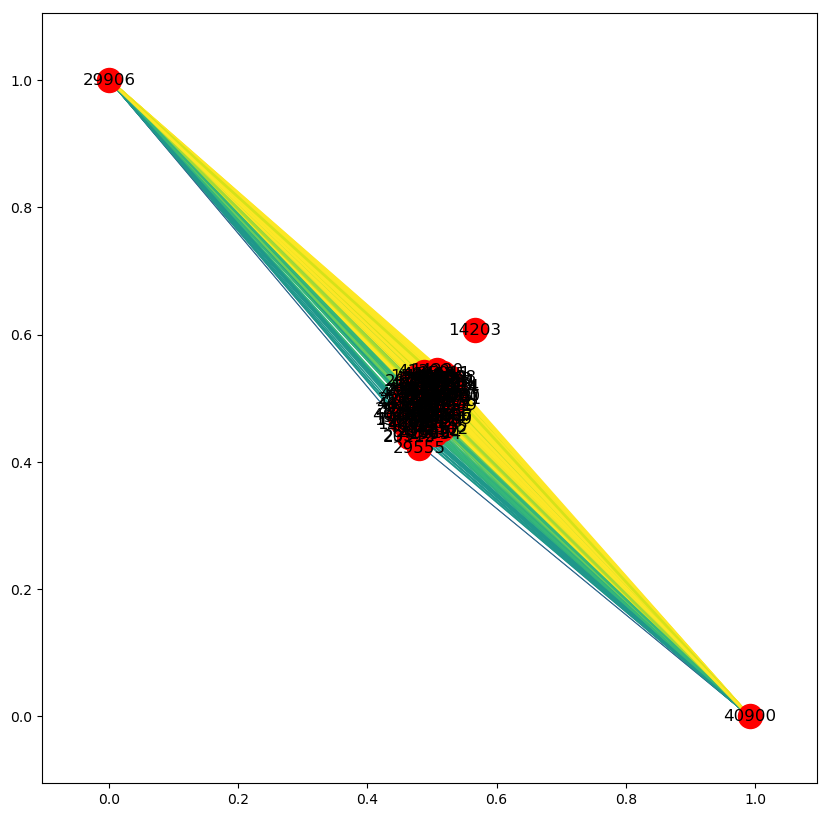

In [1072]:
nx.draw_networkx(W, width=weights, edge_color=weights)

In [1073]:
senators_wgt_dict = {}
for s in senator_nodes:
        senators_wgt_dict[s] = (W.degree(s,weight='weight'))
dt={k: v for k, v in sorted(senators_wgt_dict.items(), key=lambda item: item[1], reverse=True)}
df=pd.DataFrame.from_dict(dt, orient='index').reset_index()
df.columns = ['Senator','Degree']
#df

In order to prune the plot of the weighted projected graph, we need to select an edge weight threshold to ensure only stronger relationships. The histogram below indicates most edge weights bare less then 2.0. We will start with a threshold of 2.0 to focus the initial graph.

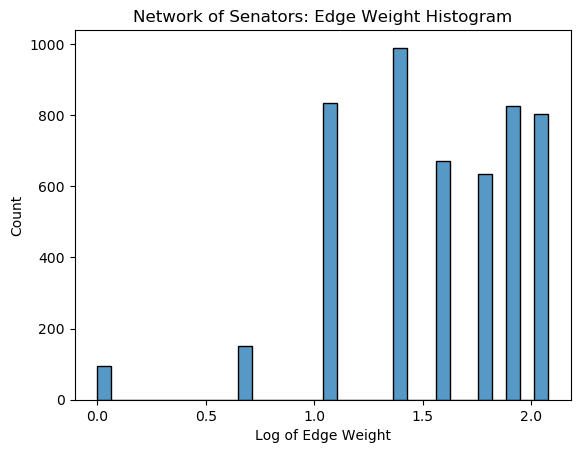

In [1074]:
# Need to create histogram of the weights
plt.rcParams.update(plt.rcParamsDefault)
sns.histplot(data=weights).set(title='Network of Senators: Edge Weight Histogram', xlabel='Log of Edge Weight', ylabel='Count');

Following the textbook example, we create a function to trim the graph edges based on a weight threshold.

In [1075]:
# From textbook
def trim_edges(g, weight=1):
    g2 = nx.Graph()
    g2.add_nodes_from(g.nodes(data=True))
    #g2 = g.__class__()
    #g2.add_nodes_from(g)
    #g2=nx.Graph()
    for f, to, edata in g.edges(data=True):
        if edata['weight'] > weight:
            g2.add_edge(f,to,edata)
    return g2

In [1076]:
## The weights histogram is logarithmic;
## we should compute the original weight = e^log_weight
Wnet_trim=trim_edges(W, weight=math.exp(2.0))
# Remove node isolates
Wnet_trim.remove_nodes_from(list(nx.isolates(Wnet_trim)))

We plot the network graph connecting Senator nodes with an edge-weight 2.0 or greater. A second plot constructed using a graphml file in Gephi provides a clearer depiction of the clusters with the Senator nodes labeled by name.

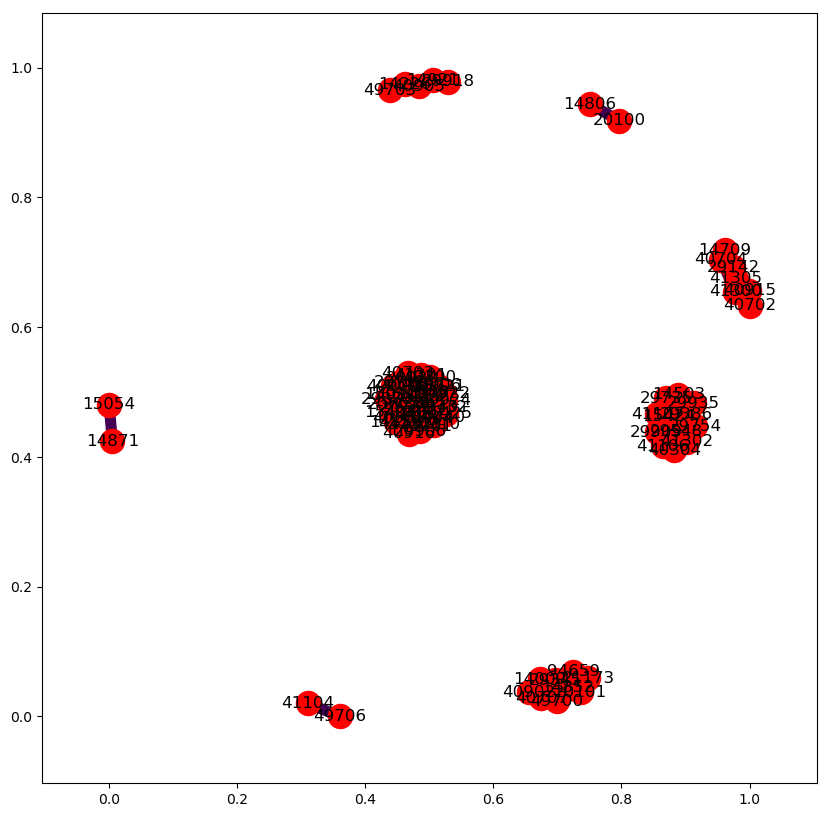

In [1077]:
## re-calculate weights based on the new graph
weights=[edata['weight'] for f,t,edata in Wnet_trim.edges(data=True)]
plt.rcParams['figure.figsize'] = [10, 10]
nx.draw_networkx(Wnet_trim,width=weights, edge_color=weights)

<img src="s113_wgt2-0.png" width="1200" />

In [1078]:
Wnet_file = "S113_Island_2-0.graphml"
nx.write_graphml( Wnet_trim, Wnet_file )

In [1079]:
g_islands = list(nx.connected_component_subgraphs(Wnet_trim))
len(g_islands)

for g in g_islands:
    df1 = (s113_members_sel_df[s113_members_sel_df['icpsr'].isin(g.nodes())][['bioname','party_code', 'nominate_dim1']])
    #print(df1)
    #print(len(df1))

The resulting graph plot indicates 8 islands or clusters. The make-up of those 8 clusters are as follows:

- 37 Democrats
- 7 Democrats
- 2 Democrats
- 12 Republicans
- 9 Republicans
- 5 Republicans
- 2 Republicans
- 2 Republicans

Now that we've established a number of distinct clusters within each party, we decrease the edge weight threshold to 1.9 in an attempt to broaden the affiliation networks and decrease the number of clusters. We expect to find two distinct clusters that fall along party lines.

In [1080]:
## The weights histogram is logarithmic;
## we should compute the original weight = e^log_weight
Wnet_trim=trim_edges(W, weight=math.exp(1.9))
Wnet_trim.remove_nodes_from(list(nx.isolates(Wnet_trim)))

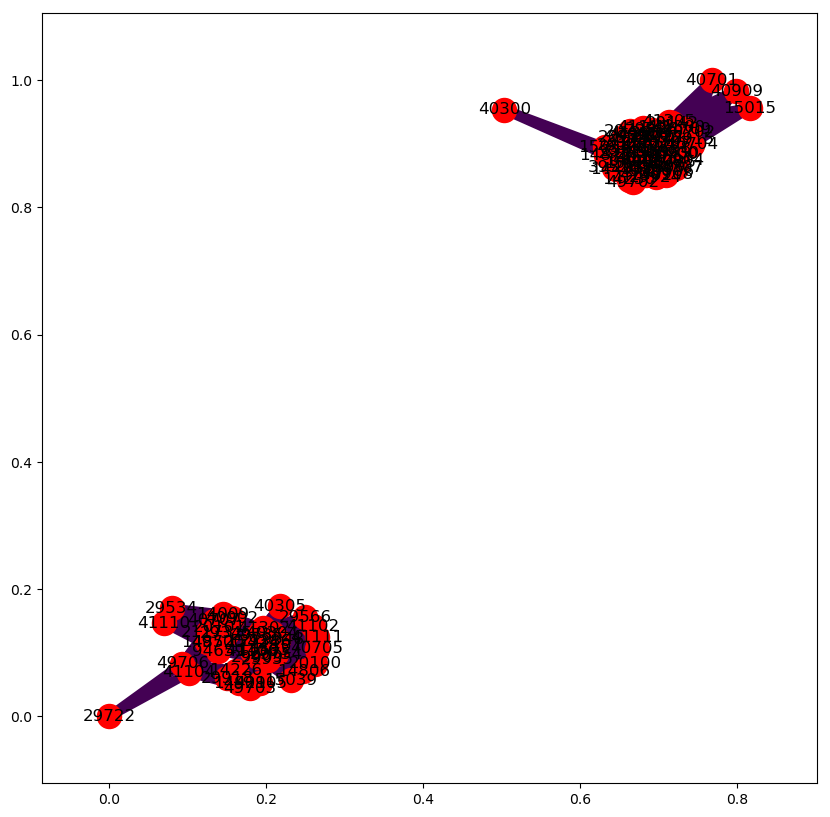

In [1081]:
## re-calculate weights based on the new graph
weights=[edata['weight'] for f,t,edata in Wnet_trim.edges(data=True)]
nx.draw_networkx(Wnet_trim,width=weights, edge_color=weights)

In [1082]:
Wnet_file = "S113_Island_1-9.graphml"
nx.write_graphml( Wnet_trim, Wnet_file )

By decreasing the threshold, we find an expected result of two distinct clusters. Let's confirm the clusters follow party lines.

In [1083]:
g_islands = list(nx.connected_component_subgraphs(Wnet_trim))
len(g_islands)

for g in g_islands:
    df1 = (s113_members_sel_df[s113_members_sel_df['icpsr'].isin(g.nodes())][['bioname','party_code']])
    #print(df1)
    #print(len(df1))

By using the graphml file of the graph object in Gephi, we are able to detect the two clusters are split along party lines except Republican Senator from Alaska, Lisa Murkowski, falls in the cluster with the Democrats (bottom left of the plot).

<img src="s113_wgt_1-9.png" width="1200" />

### Boundary Spanners
In order to find boundary spanners of the two clusters, we lower the edge weight threshold to 1.77 to ensure the resulting graph is completely connected.

In [1084]:
## The weights histogram is logarithmic;
## we should compute the original weight = e^log_weight
Wnet_trim=trim_edges(W, weight=math.exp(1.77))
Wnet_trim.remove_nodes_from(list(nx.isolates(Wnet_trim)))

In [1085]:
## re-calculate weights based on the new graph
plt.rcParams['figure.figsize'] = [10, 10]
weights=[edata['weight'] for f,t,edata in Wnet_trim.edges(data=True)]
#nx.draw_networkx(Wnet_trim,width=weights, edge_color=weights)

<img src="s113_wgt_1-77.png" width="1200" />

In [1086]:
Wnet_file = "S113_Island_1-77.graphml"
nx.write_graphml( Wnet_trim, Wnet_file )

With a fully connected graph based on the weighted projected graph, we identify 11 primary boundary spanners connecting the Democrat and Republican clusters. On the Democratic side, three individuals connect to eight individuals on the Republican side.

The Democratic side consists of:

- Harry Reid
- Ronald Lee Wyden
- Bill Nelson

The Republican side consists of:

- Lisa Murkowski
- Chuck Grassley
- Jerry Moran
- Mitch McConnell
- David Vitter
- Susan Collins
- Mike Johanns
- Dean Heller

Interestingly as before, Murkowski shares more common neighbors with Democratics for the foreign and defense policy bill votes despite being a Republican. 

## Evaluation

The use of network analysis reaffirmed assumptions about the polarization of the voting patterns for a recent Senate while also providing insights into instances of unanimous votes and individual Senators crossing the party line vote.

- By plotting the Senators according to party, we were able to clearly see the polarization in the voting patterns on Senate bills between Republicans and Democrats.
- As we narrowed the focus of the analysis to foreign and defense policy bills, we identified a three unanimous votes that indicates some topics do galvanize the support of all Senators no matter the party.
- Also, in the focused analysis, we identified the Republican Senator Lisa Murkowski shares a closer voting pattern with Democrats for the small sample size of foreign and defense policy bills.